https://www.elsevier.com/authors/policies-and-guidelines/documents/elsdoc-1.pdf

In [1]:
import pandas as pd, numpy as np, matplotlib.pyplot as plt, seaborn as sns, plotly.express as px, geopandas as gpd, folium, sys, os
from shapely.ops import unary_union
from tqdm.notebook import tqdm


%load_ext autoreload
%autoreload 2

sys.path.append('../../optimization/')
import maxcovering as mc

sys.path.append('./JG/')
import map_graphics as mg

# Definitions

In [2]:
path_data = './Data/'
overleaf_figures = r'D:\joaquimg\Dropbox\Apps\Overleaf\WHO Nepal Lancet\Figures/'
old_data_path_in_git_hub = r'D:\joaquimg\Documents\GitHub\clones\WHO_Nepal_Laboratory_Analytics\Data/'
old_data_path_out_git_hub = r'D:\joaquimg\Documents\GitHub\results\Nepal\Data\Travel Time/'

In [3]:
paper_colors = sns.color_palette('muted').as_hex()
paper_colors

['#4878d0',
 '#ee854a',
 '#6acc64',
 '#d65f5f',
 '#956cb4',
 '#8c613c',
 '#dc7ec0',
 '#797979',
 '#d5bb67',
 '#82c6e2']

# Some old data still needed

In [4]:
df_lab_owner = pd.read_excel(f'{old_data_path_in_git_hub}Nepal_Lab_Types.xlsx')
shapefile = gpd.read_file(f'{old_data_path_in_git_hub}shapefile_nepal_districts.geojson')

if os.path.exists(f'{old_data_path_out_git_hub}current_hospitals_new.pkl'):
    current_hospitals = pd.read_pickle(f'{old_data_path_out_git_hub}current_hospitals_new.pkl')
else:
    current_hospitals = pd.read_pickle(f'{old_data_path_out_git_hub}current_hospitals.pkl')
    current_hospitals.to_pickle(f'{old_data_path_out_git_hub}current_hospitals_new.pkl')


# New data from GitHub

In [5]:
population = pd.read_pickle(f'{path_data}population.pkl')
existing_labs = pd.read_pickle(f'{path_data}existing_labs.pkl')
potential_locs_hospitals = pd.read_pickle(f'{path_data}potential_locs_hospitals.pkl')     # first set, from OSM
potential_locs_healthsites = pd.read_pickle(f'{path_data}potential_locs_healthsites.pkl') # richer set
potential_locs_10kmgrid = pd.read_pickle(f'{path_data}potential_locs_10kmgrid.pkl')       # generated as a regular grid

# Ensure consistency on the laboratory names

In [6]:
assert set(existing_labs.L_NAME) == set(current_hospitals.L_NAME), set(existing_labs.L_NAME) ^ set(current_hospitals.L_NAME)
assert set(existing_labs.L_NAME) == set(df_lab_owner.Laboratory), set(existing_labs.L_NAME) ^ set(df_lab_owner.Laboratory)

# Enforce consistency in province naming

In [7]:
rename_provinces = { str(p) : f'Province {p}' for p in [1,2,5] } | { 'Sudur Pashchim' : 'Sudurpashchim', 'Lumbini' : 'Province 5' }

In [8]:
lab_descriptions = pd.merge( existing_labs, df_lab_owner, left_on='L_NAME', right_on='Laboratory' )
lab_descriptions['Owner'] = lab_descriptions['Type'].str[:1]
lab_descriptions['Latitude'] = existing_labs.geometry.apply(lambda point: point.y)
lab_descriptions['Longitude'] = existing_labs.geometry.apply(lambda point: point.x)
lab_descriptions['Laboratory'] = existing_labs.L_NAME

In [9]:
lab_descriptions['Province Name'] = [ rename_provinces.get(p,p) for p in lab_descriptions['Province'] ]
shapefile['Province Name'] = [ rename_provinces.get(p,p) for p in shapefile.Province ]

province_colors = { c : nc for c,nc in zip(set(lab_descriptions['Province Name'].values),paper_colors) }
province_colors['Nepal'] = paper_colors[len(province_colors)]
shapefile['COLOR'] = [ province_colors[c] for c in shapefile['Province Name'].values ]

<Axes: >

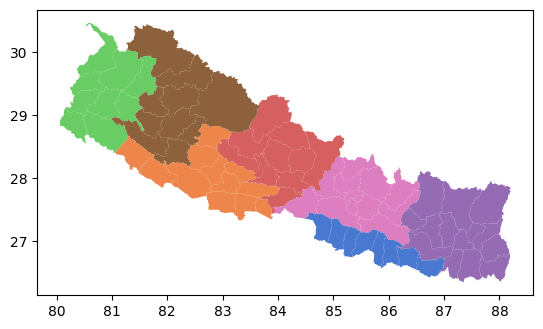

In [10]:
shapefile.plot(color=shapefile['COLOR'])

# Descriptive

# Fixing 'missing province' from [the data preparation](https://github.com/Analytics-for-a-Better-World/Public-Infrastructure-Service-Access/blob/main/publications/WHO%20Nepal%20Paper/Nepal%20Paper%20Results.ipynb)

We follow the strategy described in https://gis.stackexchange.com/questions/413715/assign-point-to-closest-polygon-using-sjoin

In [11]:
mg.ShowPoints( locations = population[['ID','ycoord','xcoord','DISTRICT']], 
               choices = { 'red' : population[ population.Province.isna() ].index }, 
               icon_style ='font-size:12px', tiles='OpenStreetMap' )

In [12]:
aux = population[['ID','xcoord','ycoord','population','geometry']].copy()
aux.crs = 'EPSG:4326'
adm = shapefile.copy().to_crs(crs=3857)
adm['original'] = adm.geometry.copy()
adm['buffered'] = adm.geometry.buffer(1500)
adm = adm.set_geometry('buffered').to_crs(crs=4326)
adjusted_population = gpd.sjoin(aux, adm, how="left", predicate="within")
adjusted_population['dist'] = gpd.GeoSeries(adjusted_population['geometry_left']).to_crs(crs=3857).distance(gpd.GeoSeries(adjusted_population['original']).to_crs(crs=3857))
adjusted_population = adjusted_population.sort_values("dist", ascending=True).groupby(["ID"]).first().reset_index(drop=False)
assert adjusted_population[['ID','xcoord','ycoord','population']].equals(population[['ID','xcoord','ycoord','population']]), 'ID mismatch after adjusting population'
assert adjusted_population[~population.Province.isna()][['ID','Province']].equals(population[~population.Province.isna()][['ID','Province']]), 'Province mismatch after adjusting population'

In [13]:
mg.ShowPoints( locations = population[['ID','ycoord','xcoord','DISTRICT']], 
               choices = { province_colors[p] : idx for p,idx in adjusted_population[population.Province.isna()].groupby(['Province Name'])['ID'].unique().reset_index().set_index('Province Name').to_dict()['ID'].items() }, 
               icon_style ='font-size:12px', tiles='OpenStreetMap' )

# Create legends for pictures in the paper

In [14]:
def CreateLegend( colors, labels, alpha, filename, dpi ):

    class Handler(object):
        def __init__(self, color, alpha):
            self.color=color
            self.alpha=alpha
        def legend_artist(self, legend, orig_handle, fontsize, handlebox):
            x0, y0 = handlebox.xdescent, handlebox.ydescent
            width, height = handlebox.width, handlebox.height
            patch = plt.Rectangle([x0, y0], width, height, facecolor=self.color, alpha=self.alpha,
                                    edgecolor='k', transform=handlebox.get_transform())
            handlebox.add_artist(patch)
            return patch
        
    def export_legend(legend, filename=filename, dpi=dpi):
        fig  = legend.figure
        fig.canvas.draw()
        bbox  = legend.get_window_extent().transformed(fig.dpi_scale_trans.inverted())
        fig.savefig(filename, dpi=dpi, bbox_inches=bbox)

    handles = [plt.Rectangle((0,0),1,1) for i  in range(len(colors))]
    hmap = dict(zip(handles, [Handler(color,alpha) for color in colors] ))

    export_legend( plt.legend(handles=handles, labels=labels, handler_map=hmap) )

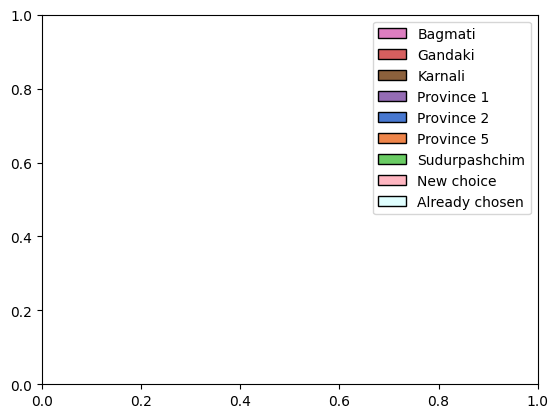

In [15]:
labels = sorted(province_colors.keys())

labels.remove('Nepal')
colors = [ province_colors[p] for p in labels ]

CreateLegend( colors, labels, .8, overleaf_figures+'legend_provinces.pdf', dpi='figure' )

labels = labels + ['Nepal']
colors = [ province_colors[p] for p in labels ]

CreateLegend( colors, labels, 1, overleaf_figures+'legend_nepal.pdf', dpi='figure' )

labels.remove('Nepal')
colors = [ province_colors[p] for p in labels ] + ['lightpink']
labels = labels + ['New choice']

CreateLegend( colors, labels, 1, overleaf_figures+'legend_opt_only_new.pdf', dpi='figure' )

colors = colors + ['lightcyan']
labels = labels + ['Already chosen']

CreateLegend( colors, labels, 1, overleaf_figures+'legend_opt.pdf', dpi='figure' )

In [16]:
lab_provinces = { lab : province for lab,province in lab_descriptions[['L_NAME','Province Name']].values }
province_geometries = { province : unary_union( shapefile[shapefile['Province Name']==province].geometry ) for province in set(shapefile['Province Name']) }

In [17]:
def style_provinces(x):
    return dict(fillColor=x['properties']['COLOR'],color='black',weight=.5,fillOpacity=.25)

def style_isochrones(x):
    return dict(fillColor='green',fillOpacity=.5,color='red',weight=1)

folium_map = mg.ShowPoints( locations = lab_descriptions[['Owner','Latitude','Longitude','Laboratory']], 
               choices = { province_colors[p] : idx for p,idx in lab_descriptions.groupby(['Province Name'])['Hosp_ID'].unique().reset_index().set_index('Province Name').to_dict()['Hosp_ID'].items() }, 
               icon_style ='font-size:12px', tiles='OpenStreetMap' )
adm = folium.GeoJson(data=shapefile, style_function=style_provinces)
adm.add_to(folium_map)

for name, data in current_hospitals[['L_NAME','60min_driving']].values:
    geo_j = folium.GeoJson(data=province_geometries[lab_provinces[name]].intersection(data),style_function=style_isochrones)
    geo_j.add_to(folium_map)

mg.FoliumToPng( folium_map=folium_map, crop=(300, 113, 1068, 627), file_name=overleaf_figures+'labs' )
folium_map

In [18]:
existing_labs_summary = lab_descriptions[['Laboratory','Type','Province Name']].drop_duplicates().reset_index(drop=True).groupby(['Province Name','Type'],as_index=True).size().unstack(level=1).fillna(0).astype(int).sort_index()
existing_labs_summary.loc['Nepal'] = existing_labs_summary.sum(numeric_only=True, axis=0)
existing_labs_summary.loc[:,'Laboratories'] = existing_labs_summary.sum(numeric_only=True, axis=1)
existing_labs_summary = existing_labs_summary[['Laboratories','Government','Private']]

In [19]:
existing_labs_summary

Type,Laboratories,Government,Private
Province Name,,,
Bagmati,50,19,31
Gandaki,6,5,1
Karnali,2,2,0
Province 1,9,5,4
Province 2,9,8,1
Province 5,9,4,5
Sudurpashchim,4,4,0
Nepal,89,47,42


In [20]:
head_count_per_province = adjusted_population[[c for c in population.columns if not c == 'geometry']].groupby('Province').sum()['population'].to_frame().astype(int).rename(index=rename_provinces).rename(index=rename_provinces).sort_index()

adm_stats = existing_labs_summary.merge(head_count_per_province,left_index=True,right_index=True).rename(columns={'population' : 'Inhabitants' })
adm_stats.loc['Nepal'] = adm_stats.sum(numeric_only=True, axis=0).round(2)
adm_stats['Labs P.M.'] = (adm_stats.Laboratories / adm_stats.Inhabitants * 1e6).round(2)

import pyperclip
pyperclip.copy(adm_stats.style.format(decimal='.', thousands=',', precision=2).to_latex())

adm_stats

,Laboratories,Government,Private,Inhabitants,Labs P.M.
Bagmati,50,19,31,7783878,6.42
Gandaki,6,5,1,1691668,3.55
Karnali,2,2,0,1078543,1.85
Province 1,9,5,4,5974835,1.51
Province 2,9,8,1,5648457,1.59
Province 5,9,4,5,3720260,2.42
Sudurpashchim,4,4,0,3237606,1.24
Nepal,89,47,42,29135247,3.05


In [21]:
lab_counts = lab_descriptions[['Date Open','L_NAME','Province Name']].pivot_table(index='Date Open',columns='Province Name',aggfunc=len,fill_value=0,margins=True, margins_name='Nepal').reset_index().set_index('Date Open')
lab_counts.drop(lab_counts.tail(1).index,inplace=True)
lab_counts.columns = list(zip(*lab_counts.columns.values))[1]

In [22]:
def AdjustColumnsForLegendAndColorsForLinePlots( df, colors, n=2, d=0 ):
    _min = df.min().to_dict()
    _max = df.max().to_dict()
    original = df.columns.to_list()
    max_c = max([len(o) for o in original])
    df.columns = [f'{_min[c]:{n}.{d}f}-{_max[c]:{n}.{d}f} {c:<{max_c}}' for c in df.columns]
    return df, { c : colors[o] for c,o in zip(df.columns,original) }       

In [23]:
aux, colors = AdjustColumnsForLegendAndColorsForLinePlots( lab_counts.cumsum(), province_colors )
mg.draw_lines( aux,
              x=aux.index,y=aux.columns,
              x_title=None, 
              y_title='Number of Laboratories',
              width=600,height=300,
              colors=colors,
              line_width=5, horizontal_legend=False,
              file_name=overleaf_figures+'nof_labs_2021.pdf')

In [24]:
is_chrone = lambda c : 'min' in c and c.startswith('ID')

In [25]:
assert list(filter(is_chrone, existing_labs.columns)) == list(filter(is_chrone, potential_locs_healthsites.columns))
assert list(filter(is_chrone, existing_labs.columns)) == list(filter(is_chrone, potential_locs_10kmgrid.columns))

In [26]:
chrone_columns = list(filter(is_chrone, existing_labs.columns))

In [27]:
all_facs = pd.concat([existing_labs[chrone_columns],potential_locs_healthsites[chrone_columns]],ignore_index=True)
household = adjusted_population.population.astype(np.uint).values
already_open = all_facs.index[:len(existing_labs)].values

In [28]:
assert len( set(all_facs.index) ) == len( all_facs.index ), 'indices not unique'

In [29]:
for df in [all_facs, existing_labs, potential_locs_10kmgrid, potential_locs_healthsites, potential_locs_hospitals ]:
    for c in all_facs.columns:
        assert( set( mc.all_in( [ l for l in df[c].values if l ] ) ).issubset( set( range(len(household))) ) ), f'unknown households in {c} reach of facilities'

In [30]:
def ShowServeNobody( locations, metric='ID_60min_driving' ):
    idx = locations[metric].apply(len) == 0
    isolated = pd.concat([locations.ID,locations.geometry.y,locations.geometry.x,locations.ID],axis=1)[idx]
    return mg.ShowPoints( locations = isolated, choices = { 'red' : isolated.index.values }, icon_style ='font-size:7px', tiles='OpenStreetMap' )

In [31]:
ShowServeNobody( potential_locs_10kmgrid, metric='ID_60min_walking' )

In [32]:
if os.path.exists('opt_results.pkl'):
    results = pd.read_pickle('opt_results.pkl')
else:
    M = len(already_open)
    M_new = len(all_facs)-len(already_open)+1
    results = pd.DataFrame()
    for c in all_facs.columns:
        I, J, IJ, JI = mc.CreateIndexMapping( all_facs[c], household )
        results_fixing = mc.OptimizeWithGurobipy( household,I,J,IJ, np.arange(1,M_new,1), parsimonious=True, already_open=already_open, trace=False, progress=tqdm )
        results[' '.join(c.split('_')[1:])] = ( results_fixing.value / sum(household) * 100 ).astype(float).round(1)
    results.to_pickle('opt_results.pkl')

Set parameter Username
Academic license - for non-commercial use only - expires 2023-11-02


  0%|          | 0/1682 [00:00<?, ?it/s]

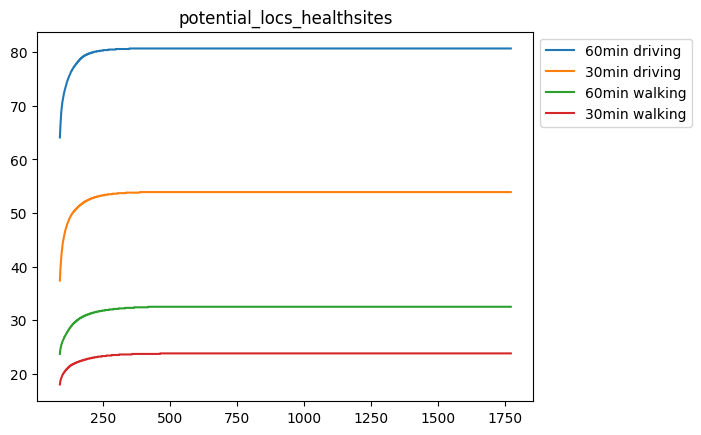

In [ ]:
ax = results.plot()
ax.set_title("potential_locs_healthsites",color='black')
ax.legend(bbox_to_anchor=(1.0, 1.0))
ax.plot()
plt.show()

In [ ]:
end_of_growth = max( np.argmax( results, axis=0 ) ) + 1

In [ ]:
aux = pd.concat( [results.max().to_frame(), results[:end_of_growth].max().to_frame()], axis=1 )
aux.columns=['complete','beginning']
assert all( aux['complete'] == aux['beginning'] )
aux

,complete,beginning
60min driving,80.7,80.7
30min driving,53.9,53.9
60min walking,32.5,32.5
30min walking,23.8,23.8


In [ ]:
aux, colors = AdjustColumnsForLegendAndColorsForLinePlots(results[:end_of_growth], dict(zip(results.columns,sns.color_palette('muted').as_hex())) )
mg.draw_lines(aux, 
              y=aux.columns, 
              x_title='total number of facilities, including the existing 89', 
              y_title='% population with access', 
              width=900,height=500,line_width=5,
              horizontal_legend=True,
              colors=colors)

In [ ]:
end_of_growth/len(potential_locs_healthsites)*100

22.294887039239

In [ ]:
def purify( lol ):
    return [l for l in lol if l]

In [ ]:
coverage_obtained_in_nepal = lab_descriptions.groupby(['Date Open'])['Hosp_ID'].unique().reset_index().set_index('Date Open')
coverage_obtained_in_nepal['sol'] = coverage_obtained_in_nepal['Hosp_ID'].apply(list).cumsum()
for c in chrone_columns:
    coverage_obtained_in_nepal[' '.join(c.split('_')[1:])] = coverage_obtained_in_nepal['sol'].apply( lambda s : household[mc.all_in(purify(lab_descriptions[lab_descriptions['Hosp_ID'].isin(s)][c].values))].sum()/household.sum()*100 )
done = coverage_obtained_in_nepal[coverage_obtained_in_nepal.columns[-4:]]
done, colors = AdjustColumnsForLegendAndColorsForLinePlots(done, dict(zip(done.columns,sns.color_palette('muted').as_hex())), n=4, d=1 )
mg.draw_lines(done, 
              y=done.columns, 
              x_title='total number of facilities, including the existing 89', 
              y_title='% population with access', 
              width=1000,height=500,line_width=5,
              horizontal_legend=True,
              colors=colors)

In [ ]:
coverage_obtained_in_nepal

,Hosp_ID,sol,60min driving,30min driving,60min walking,30min walking
Date Open,,,,,,
2021-05-01,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...","[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...",55.248847,32.918248,21.250793,16.254820
2021-05-03,[69],"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...",55.248847,32.922649,21.277280,16.273275
2021-05-15,"[70, 71]","[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...",57.520799,33.788988,21.597006,16.354534
2021-05-16,[72],"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...",57.646764,33.822449,21.601907,16.357098
2021-05-18,"[73, 74]","[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...",57.754829,33.862991,21.619909,16.400482
2021-05-19,[75],"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...",58.140547,34.174246,21.814526,16.461632
2021-05-22,[76],"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...",59.636131,34.490358,21.943342,16.521830
2021-06-03,"[77, 78]","[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...",61.274940,34.934772,22.079542,16.564654
2021-06-11,[79],"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13,...",61.279837,34.977884,22.126643,16.666895


In [ ]:
beginning = coverage_obtained_in_nepal.iloc[0]['sol']
M = len(beginning)
M_new = 20
results = pd.DataFrame()
for c in all_facs.columns:
    I, J, IJ, JI = mc.CreateIndexMapping( all_facs[c], household )
    results_fixing = mc.OptimizeWithGurobipy( household,I,J,IJ, np.arange(0,M_new+1,1), parsimonious=True, already_open=beginning, trace=False, progress=tqdm )
    results[' '.join(c.split('_')[1:])] = ( results_fixing.value / sum(household) * 100 ).astype(float).round(1)


  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

  0%|          | 0/21 [00:00<?, ?it/s]

In [ ]:
len( beginning )

69

In [ ]:
set( coverage_obtained_in_nepal.iloc[0].sol ) - set(beginning), set(beginning) - set( coverage_obtained_in_nepal.iloc[0].sol ) 

(set(), set())

In [ ]:
set(beginning) - set(results_fixing.iloc[0].solution), set(results_fixing.iloc[0].solution) - set(beginning)

(set(), set())

In [ ]:
aux, colors = AdjustColumnsForLegendAndColorsForLinePlots(results, dict(zip(results.columns,sns.color_palette('muted').as_hex())), n=4, d=1 )
mg.draw_lines(aux, 
              y=aux.columns, 
              x_title='total number of facilities, including the existing 89', 
              y_title='% population with access', 
              width=1000,height=500,line_width=5,
              horizontal_legend=True,
              colors=colors)

In [ ]:
results

,55.2-71.7 60min driving,32.9-45.1 30min driving,21.3-26.4 60min walking,16.3-20.0 30min walking
69,55.2,32.9,21.3,16.3
70,57.6,35.1,22.7,16.9
71,59.8,36.3,23.3,17.4
72,61.4,37.3,23.6,17.8
73,62.9,38.0,23.8,18.1
74,64.1,38.7,24.1,18.4
75,65.1,39.4,24.3,18.5
76,66.0,40.0,24.5,18.7
77,66.7,40.6,24.6,18.8
78,67.5,41.1,24.8,18.9
